# Covac Analysis

In [1]:
import datetime
import numpy as np
import pandas as pd
import scanpy as sc
from matplotlib import pyplot as plt

import seaborn as sns
sns.set_theme("paper")
sns.set_style("whitegrid")

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

import numba
from numba.core.errors import NumbaDeprecationWarning, NumbaPendingDeprecationWarning
warnings.simplefilter("ignore", category=NumbaDeprecationWarning)

# pandas warning
warnings.filterwarnings("ignore", category=pd.errors.PerformanceWarning)

import os

In [2]:
# global monoscale palette
mono_palette = sns.color_palette("Reds", as_cmap=True)

In [3]:
FIGURE_DIR = "./figures"

In [4]:
import os
DATA_DIR = "/home/ubuntu/data"
corona_ann = sc.read_h5ad(os.path.join(DATA_DIR, "COVAC_preprocessed.h5ad"))

In [5]:
corona_ann.raw = None

In [6]:
# Fix uns data, which is not being saved for some reason ...
if corona_ann.uns.get("log1p") is not None:
    if (corona_ann.uns["log1p"].get("base") is None):
        print("... fixing .uns['log1p']") 
        corona_ann.uns["log1p"] = {"base": None}

... fixing .uns['log1p']


## Subsetting

In [7]:
print(corona_ann.obs.patientID.unique().to_numpy())
print(corona_ann.obs.timepoint.unique().to_numpy())

['B12' 'P16' 'P8' 'B4' 'B9' 'P6' 'B6' 'B10' 'B13' 'B3' 'P7' 'B2' 'P4' 'B1']
['t3' 'd28' 'd56' 't2' 't4' 't1' 'M6' 'd1']


In [8]:
# reduce to one cohort
#corona_ann = corona_ann[corona_ann.obs.cohort == "B", :].copy()

# reduce to just the first timepoint
#corona_ann = corona_ann[corona_ann.obs.timepoint.isin(["t2", "d28"]), :].copy()

# reduce to one patient
#corona_ann = corona_ann[corona_ann.obs.patientID == "B1", :].copy()

# don't reduce

## Calculate Highly Variable Genes

In [9]:
sc.pp.highly_variable_genes(corona_ann, min_mean=0.005, max_mean=3, min_disp=0.5)
print(sum(corona_ann.var.highly_variable))

1456


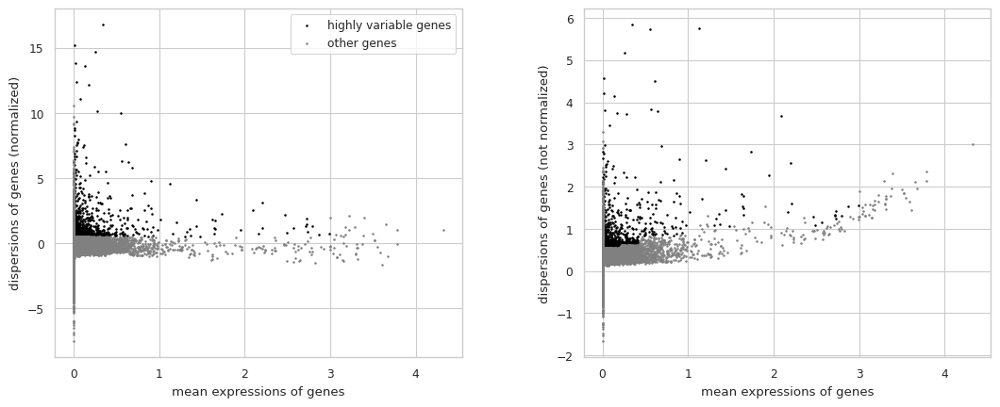

In [192]:
sc.pl.highly_variable_genes(corona_ann, save=".png")

## Scale Data

In [11]:
start = datetime.datetime.now()
## scaling: Scaling will reduce sparsity, but the penalty and fit work better with centered data
sc.pp.scale(corona_ann, zero_center=True, copy=False)
print(datetime.datetime.now() - start)

0:01:21.819336


## PCA

In [12]:
NUM_COMPONENTS = 80

In [13]:
# pca with 100 components on the highly variable genes
start = datetime.datetime.now()
sc.pp.pca(corona_ann, n_comps=NUM_COMPONENTS, use_highly_variable=True)
print(datetime.datetime.now() - start)

0:01:09.315530


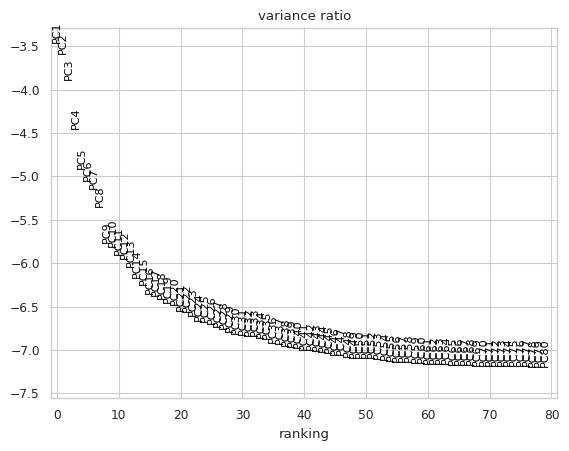

In [193]:
sc.pl.pca_variance_ratio(corona_ann, n_pcs=min(NUM_COMPONENTS, 100), log=True, save=".png")

## Batch Correction

**LEARNING: More Genes -> Better separation, but more batch effects.**

Allowing (nearly) all genes, gives UMAP enough dimensionality to (partially) separate patients.
TODO: Try using less stringent hvg selection!

### Initial UMAP

In [15]:
start = datetime.datetime.now()
sc.pp.neighbors(corona_ann, use_rep="X_pca", n_pcs=NUM_COMPONENTS)
sc.tl.umap(corona_ann)
corona_ann.obsm["X_umap_raw"] = corona_ann.obsm["X_umap"].copy()
print(datetime.datetime.now() - start)

0:07:45.695347


/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/tmp/ipykernel_2140420/880689057.py:8: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


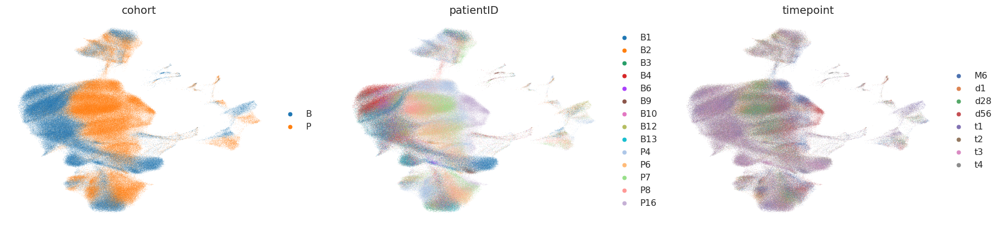

In [264]:
corona_ann.obsm["X_umap"] = corona_ann.obsm["X_umap_raw"]
fig = sc.pl.umap(corona_ann, components="1,2", color=["cohort", "patientID", "timepoint"],
                 frameon=False, legend_fontsize="large", return_fig=True)

for ax in fig.get_axes():
    ax.title.set_fontsize(14)

fig.tight_layout()
fig.savefig(os.path.join(FIGURE_DIR, "covid_processed_init_umap.png"))

### Harmony Batch Integration 

Produces a corrected PCA embedding. No correction of counts!

In [17]:
import scanpy.external as sce

# run batch correction with harmony on patientID AND timepoint
sce.pp.harmony_integrate(corona_ann, ["patientID", "timepoint"], basis="X_pca", adjusted_basis="X_pca_harmony", max_iter_harmony=15, random_state=123)

2023-10-09 13:18:04,879 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-10-09 13:20:15,732 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-10-09 13:20:18,199 - harmonypy - INFO - Iteration 1 of 15
2023-10-09 13:24:44,326 - harmonypy - INFO - Iteration 2 of 15
2023-10-09 13:28:57,384 - harmonypy - INFO - Iteration 3 of 15
2023-10-09 13:33:22,314 - harmonypy - INFO - Iteration 4 of 15
2023-10-09 13:37:40,320 - harmonypy - INFO - Iteration 5 of 15
2023-10-09 13:39:37,094 - harmonypy - INFO - Iteration 6 of 15
2023-10-09 13:41:24,299 - harmonypy - INFO - Iteration 7 of 15
2023-10-09 13:43:01,456 - harmonypy - INFO - Iteration 8 of 15
2023-10-09 13:44:40,619 - harmonypy - INFO - Iteration 9 of 15
2023-10-09 13:49:06,513 - harmonypy - INFO - Iteration 10 of 15
2023-10-09 13:53:30,270 - harmonypy - INFO - Iteration 11 of 15
2023-10-09 13:55:27,852 - harmonypy - INFO - Iteration 12 of 15
2023-10-09 13:57:04,591 - harmonypy - INFO - Iteration 13 of

In [18]:
start = datetime.datetime.now()
sc.pp.neighbors(corona_ann, use_rep="X_pca_harmony", key_added="neighbors_harmony", n_pcs=NUM_COMPONENTS)
sc.tl.umap(corona_ann, neighbors_key="neighbors_harmony")  # overwrites obsm["X_umap"]
corona_ann.obsm["X_umap_harmony"] = corona_ann.obsm["X_umap"].copy()
print(datetime.datetime.now() - start)

0:07:28.160407


/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/tmp/ipykernel_2140420/3946759424.py:8: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


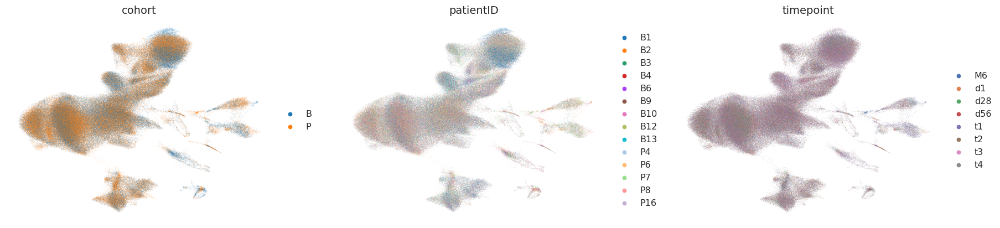

In [265]:
corona_ann.obsm["X_umap"] = corona_ann.obsm["X_umap_harmony"]
fig = sc.pl.umap(corona_ann, color=["cohort", "patientID", "timepoint"],
                 frameon=False, legend_fontsize="large", return_fig=True)

for ax in fig.get_axes():
    ax.title.set_fontsize(14)

fig.tight_layout()
fig.savefig(os.path.join(FIGURE_DIR, "covid_processed_corrected_umap.png"))

### MMNpy Batch correction

Corrects the counts by matching mutual nearest neighbors

In [20]:
#import scanpy.external as sce
#sce.pp.mnn_correct(corona_ann, batch_key="patientID", n_jobs=10)

In [21]:
#start = datetime.datetime.now()
#sc.pp.neighbors(corona_ann, use_rep="X", key_added="neighbors_mmnpy")
#sc.tl.umap(corona_ann, neighbors_key="neighbors_mmnpy")  # overwrites obsm["X_umap"]
#corona_ann.obsm["X_umap_mmnpy"] = corona_ann.obsm["X_umap"].copy()
#print(datetime.datetime.now() - start)

In [22]:
#sc.pl.umap(corona_ann, color=["cohort", "patientID"])

## Clustering

In [23]:
start = datetime.datetime.now()
# Clustering
sc.tl.leiden(corona_ann, resolution=1, neighbors_key="neighbors_harmony")
print(datetime.datetime.now() - start)

0:15:54.888434


/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


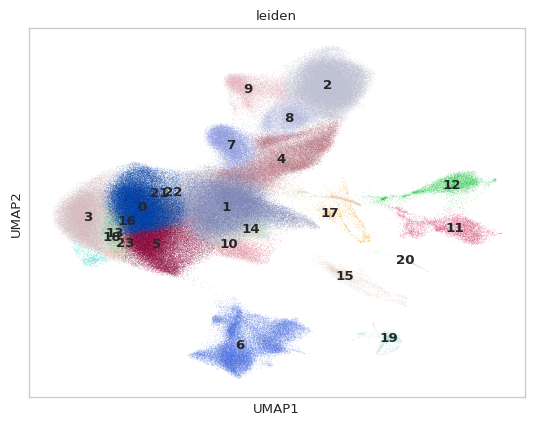

In [190]:
#corona_ann.obsm["X_umap"] = corona_ann.obsm["X_umap_raw"]
corona_ann.obsm["X_umap"] = corona_ann.obsm["X_umap_harmony"]
fig = sc.pl.umap(corona_ann, dimensions=[(0,1)], color=["leiden"], legend_loc="on data", return_fig=True)
fig.savefig(os.path.join(FIGURE_DIR, "covid_processed_corrected_umap_clusters.png"))

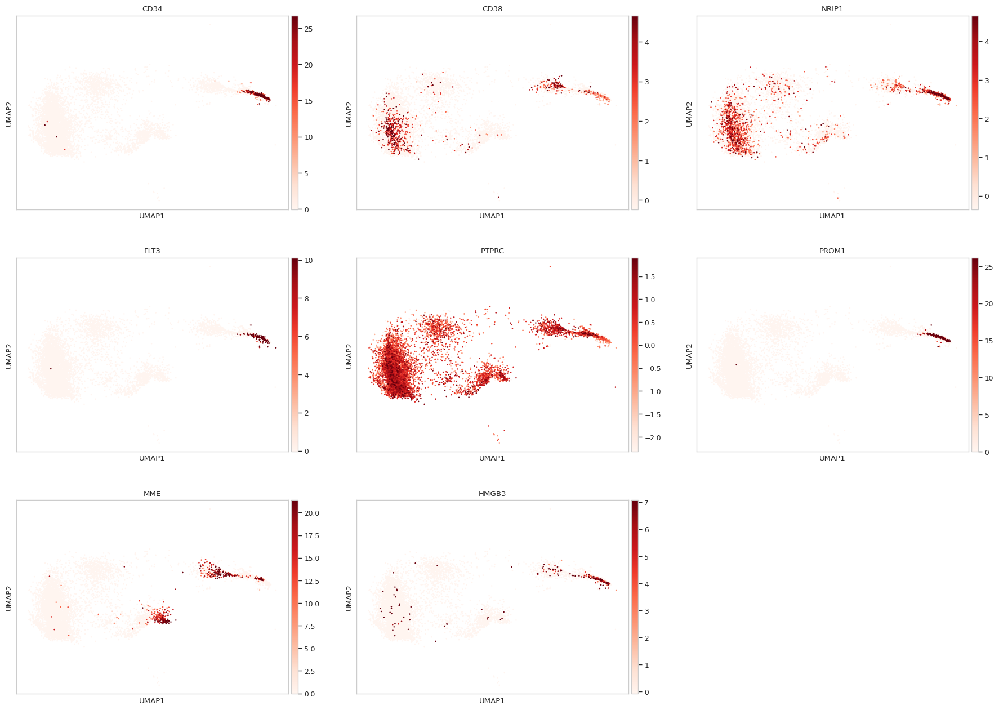

In [419]:
fig = sc.pl.umap(corona_ann[corona_ann.obs.leiden.isin(["13", "16", "23", "21", "22"])],
           vmax="p99",
           cmap="Reds",
           ncols=3,
           color=["CD34", "CD38", "NRIP1", "FLT3", "PTPRC", "PROM1", "MME", "HMGB3"],
          return_fig=True)

fig.savefig(os.path.join(FIGURE_DIR, "covid_processed_corrected_umap_lpc.png"))

Use a higher resolution, to separate naive CD8 and CD4, as well as CD16+ and CD14+ Monocytes

## Differentially expressed genes

In [27]:
sc.tl.rank_genes_groups(corona_ann, "leiden", use_raw=False, method="t-test")

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.

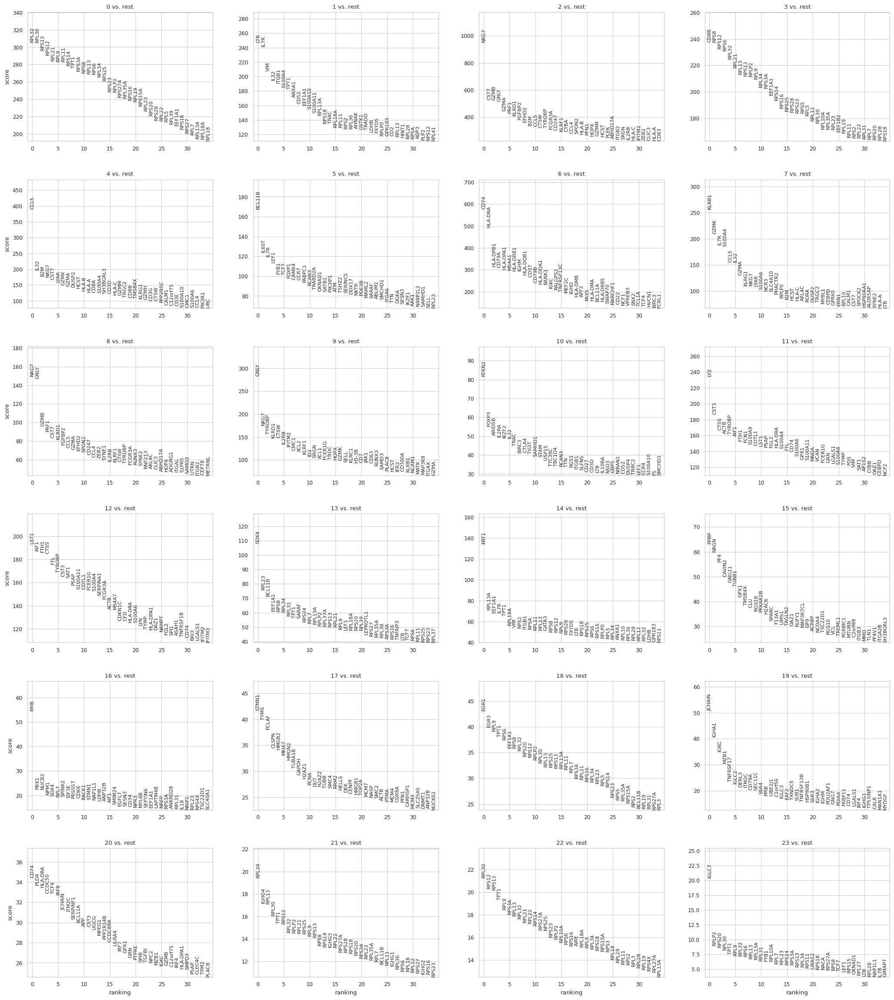

In [28]:
sc.pl.rank_genes_groups(corona_ann, n_genes=35, sharey=False, save=".png")

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


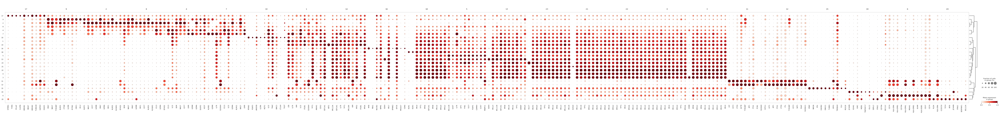

In [29]:
sc.tl.dendrogram(corona_ann, groupby="leiden", use_rep="X_pca")
sc.pl.rank_genes_groups_dotplot(corona_ann, standard_scale="var", cmap=mono_palette)

## Annotate cell types

### Marker genes

#### T cell subtypes
Resource: [abcam t cells basic immunophenotyping](https://www.abcam.com/primary-antibodies/t-cells-basic-immunophenotyping),
[Guide to human CD antigens](https://docs.abcam.com/pdf/immunology/Guide-to-human-CD-antigens.pdf?utm_content=HumanCDMarkersGated&elqtrackid=7309ba7c4dd342fd95b2c5ff3dfb8a49&elqaid=3690&elqat=2)

In [30]:
# https://www.abcam.com/primary-antibodies/t-cells-basic-immunophenotyping
t_markers = [
    "CD3D",    # All T Cells
    "CD8A",    # Killer T Cells
    "CD8B",    # Killer T Cells
    "IFNG",   # Activated Killer T Cells
    "TNF",    # Activated Killer T Cells
    "EOMES",  # Transcription Factor in Killer T Cells
    "CD4",    # Helper T Cells
    "CXCR3",  # Helper Th1 Cells
    "IFNG",   # Helper Th1 Cells
    "IL2",   # Helper Th1 Cells
    "IL12A", "IL12B",  # (orig: IL12) Helper Th1 Cells
    "IL18",  # Helper Th1 Cells
    "STAT4",  # Helper Th1 Cells
    "STAT1",  # Helper Th1 Cells
    "CCR4",   # Helper Th2 Cells
    "IL2",   # Helper Th2 Cells
    "IL4",   # Helper Th2 Cells
    "IL2RA",   # (orig: CD25) Treg Cells
    "IL7R",  # (orig: CD127) Treg Cells
    "CTLA4",  # (orig: CD152) Treg Cells
    "TGFB1","TGFB2", "TGFB3",   # (orig: TGFB) Treg Cells
    "IL10",  # Treg Cells
    #"IL12",  # Treg Cells
    "FOXP3",  # (orig: FoxP3) Transcription Factor in Treg Cells
    "STAT5A", "STAT5B"  # (orig: STAT5) Transcription Factor in Treg Cells
]
    

#### PBMC Markers 
Source: Scanpy Tutorial

In [31]:
pbmc_markers = [   "CD74",                                          #x# MHC II (professional APCs)
                   "PTPRC",                                         #x# Leukocyte common antigen
                   "CD3D", "CD3G", "CD3E",                          #x# T-cells (TCR Co-Receptor)
                   "IL7R", "CCR7",                                  #x# naive T-cells 
                   "S100A4",                                        #x# memory T-cells
                   "CD8A", "CD8B",                                  #x# CD8+ T-cells (cytotoxic T-cells)
                   "CD4",                                           #x# CD4+ T-cells (helper T-cells)
                   "JCHAIN",                                        #x# Plasma Cells ?? 
                   "MS4A1", "CD19", "CD24", "CD38", "CD79A",        #x# B-Cells
                   "NKG7", "GNLY", "KLRB1",                         #x# NK
                   "CD14", "FCN1", "LYZ",                           #x# CD14+ Monocytes (Macrophages / Dendritic Cells)
                   "FCER1A", "CST3",                                #x# Dendritic Cells
                   "FCGR3A", "MS4A7",                               #x# FCGR3A+ (CD16A=FCGR3A) Monocytes, Neutrophils, Macrophages, (some) T-cells
                   "PPBP", "PF4",                                   # Megakaryocytes
                   "CD34", "SPINK2",  "PROM1", # PROM1=CD133        # Mast cells / Hematopoietic Stem cells
                   "S100A8", "S100A9", "IFITM2",                    # Neutrophils -> Note: Not mononuclear, should not be contained!
                  ]

#### Detailed Markers

Reference: Lists above and [annotation tutorial by sc-best-practices](https://www.sc-best-practices.org/cellular_structure/annotation.html)

In [142]:
# FROM THIS TUTORIAL: https://www.sc-best-practices.org/cellular_structure/annotation.html
marker_genes = {
    "CD14+ Mono": ["FCN1", "CD14", "LYZ"],                          # CD14+ Monocytes (Macrophages / Dendritic Cells)
    "CD16+ Mono": ["TCF7L2", "FCGR3A", "LYN"],
    "ID2-hi myeloid prog": [
        "CD14",
        "ID2",
        "VCAN",
        "S100A9",
        "CLEC12A",
        "KLF4",
        "PLAUR",
    ],
    "cDC1": ["CLEC9A", "CADM1"],                                    # Dendritic
    "cDC2": [                                                       # Dendiritc
        "CST3",
        "COTL1",
        "LYZ",
        "DMXL2",
        "CLEC10A",
        "FCER1A",
    ],  # Note: DMXL2 should be negative
    "Normoblast": ["SLC4A1", "SLC25A37", "HBB", "HBA2", "HBA1", "TFRC"],
    "Erythroblast": ["MKI67", "HBA1", "HBB"],
    "Proerythroblast": [
        "CDK6",
        "SYNGR1",
        "HBM",
        "GYPA",
    ],  # Note HBM and GYPA are negative markers
    "NK": ["GNLY", "NKG7", "CD247", "GRIK4", "FCER1G", "TYROBP", "KLRG1", "FCGR3A", "KLRB1"],
    "ILC": ["ID2", "PLCG2", "GNLY", "SYNE1"],                         # Innate Lymphoid Cells
    "Lymph prog": [
        "CD34", "CD38", "FLT3", "PTPRC", "PROM1", "MME", "HMGB3",
        "VPREB1",
        "MME",
        "EBF1",
        "SSBP2",
        "BACH2",
        "CD79B",
        "IGHM",
        "PAX5",
        "PRKCE",
        "DNTT",
        "IGLL1",
    ],
    "B": ["CD19", "CD79A"],
    "Naive CD20+ B": ["MS4A1", "IL4R", "IGHD", "FCRL1", "IGHM"],
    "B1 B": [
        "MS4A1",
        "SSPN",
        "ITGB1",
        "EPHA4",
        "COL4A4",
        "PRDM1",
        "IRF4",
        "CD38",
        "XBP1",
        "PAX5",
        "BCL11A",
        "BLK",
        "IGHD",
        "IGHM",
        "ZNF215",
    ],  # Note IGHD and IGHM are negative markers
    "Transitional B": ["MME", "CD38", "CD24", "ACSM3", "MSI2"],
    "Plasma cells": [
        "CD27", "SDC1", # (=CD138)
        "CD38", "SLAMF7", # (=CD319)
        "MZB1", "HSP90B1", "FNDC3B", "PRDM1", "IGKC", "JCHAIN"],
    "Plasmablast": ["XBP1", "RF4", "PRDM1", "PAX5"],  # Note PAX5 is a negative marker
    "T": ["CD3D", "CD3G", "CD3E"],   # TCR co-receptor
    "T reg": ["IL2RA", "IL7R","CTLA4", "TGFB1", "TGFB2", "TGFB3", "IL10", "FOXP3", "STAT5A", "STAT5B"],
    "CD4+ T activated": ["CD4", "IL7R", "TRBC2", "ITGB1"],
    "CD4+ T naive": ["CD4", "IL7R", "TRBC2", "CCR7"],
    "CD8+ T": ["CD8A", "CD8B", "GZMK", "GZMA", "CCL5", "GZMB", "GZMH", "GZMA"],
    "T activation": ["CD69", "CD38"],  # CD69 much better marker!
    "T naive": ["LEF1", "CCR7", "TCF7"],
    "pDC": ["GZMB", "IL3RA", "COBLL1", "TCF4"],
    "G/M prog": ["MPO", "BCL2", "KCNQ5", "CSF3R"],
    "HSC": ["NRIP1", "MECOM", "PROM1", "NKAIN2", "CD34"],
    "MK/E prog": [
        "ZNF385D",
        "ITGA2B",
        "RYR3",
        "PLCB1",
    ],  # Note PLCB1 is a negative marker
}

In [144]:
for ct, markers in marker_genes.items():
    print("%s\t & %s \\\\" % (ct, ", ".join(markers)))

CD14+ Mono	 & FCN1, CD14, LYZ \\
CD16+ Mono	 & TCF7L2, FCGR3A, LYN \\
ID2-hi myeloid prog	 & CD14, ID2, VCAN, S100A9, CLEC12A, KLF4, PLAUR \\
cDC1	 & CLEC9A, CADM1 \\
cDC2	 & CST3, COTL1, LYZ, DMXL2, CLEC10A, FCER1A \\
Normoblast	 & SLC4A1, SLC25A37, HBB, HBA2, HBA1, TFRC \\
Erythroblast	 & MKI67, HBA1, HBB \\
Proerythroblast	 & CDK6, SYNGR1, HBM, GYPA \\
NK	 & GNLY, NKG7, CD247, GRIK4, FCER1G, TYROBP, KLRG1, FCGR3A, KLRB1 \\
ILC	 & ID2, PLCG2, GNLY, SYNE1 \\
Lymph prog	 & CD34, CD38, NRIP1, FLT3, PTPRC, PROM1, MME, HMGB3, VPREB1, MME, EBF1, SSBP2, BACH2, CD79B, IGHM, PAX5, PRKCE, DNTT, IGLL1 \\
B	 & CD19, CD79A \\
Naive CD20+ B	 & MS4A1, IL4R, IGHD, FCRL1, IGHM \\
B1 B	 & MS4A1, SSPN, ITGB1, EPHA4, COL4A4, PRDM1, IRF4, CD38, XBP1, PAX5, BCL11A, BLK, IGHD, IGHM, ZNF215 \\
Transitional B	 & MME, CD38, CD24, ACSM3, MSI2 \\
Plasma cells	 & CD27, SDC1, CD38, SLAMF7, MZB1, HSP90B1, FNDC3B, PRDM1, IGKC, JCHAIN \\
Plasmablast	 & XBP1, RF4, PRDM1, PAX5 \\
T	 & CD3D, CD3G, CD3E \\
T reg	 & IL2R

In [55]:
marker_genes_in_data = dict()
for ct, markers in marker_genes.items():
    markers_found = list()
    for marker in markers:
        if marker in corona_ann.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

### Plot Markers over UMAP

In [34]:
dendritic_ct = ["cDC1", "cDC2", "pDC"]
mk_e_prog = ["MK/E prog"]


#### Precursors

HSC Markers: [biotechne resource](https://www.rndsystems.com/research-area/hematopoietic-progenitor-cell-markers)

In [58]:
hpc_ct = ["HSC", "MK/E prog", "G/M prog", "Lymph prog", "ID2-hi myeloid prog"]

HSC:


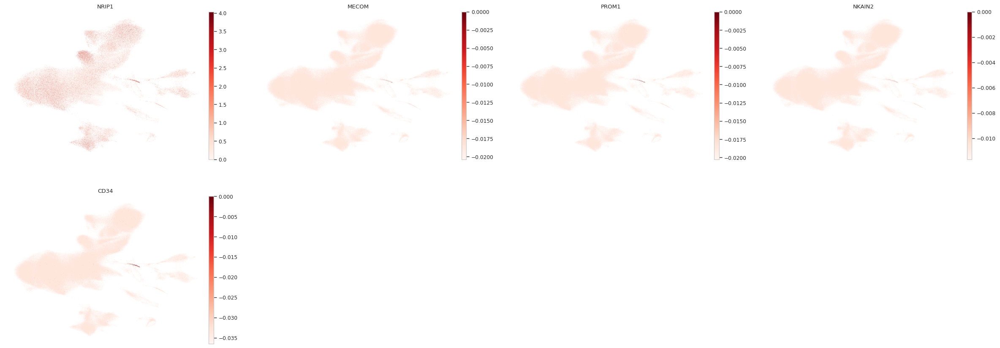





MK/E PROG:


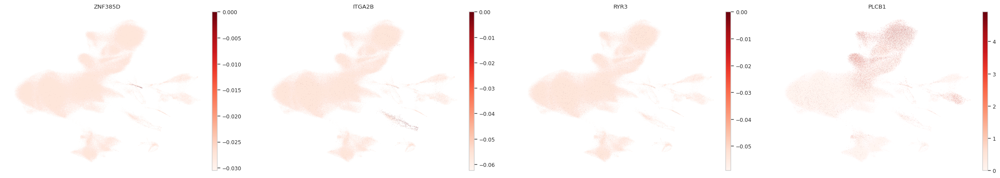





G/M PROG:


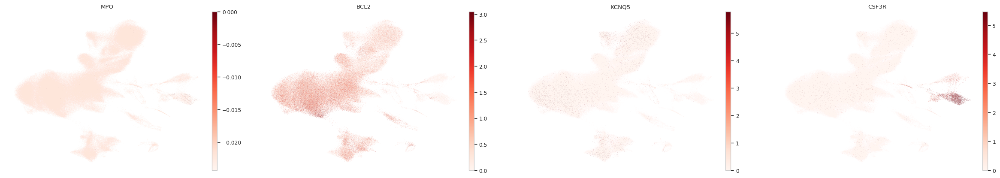





LYMPH PROG:


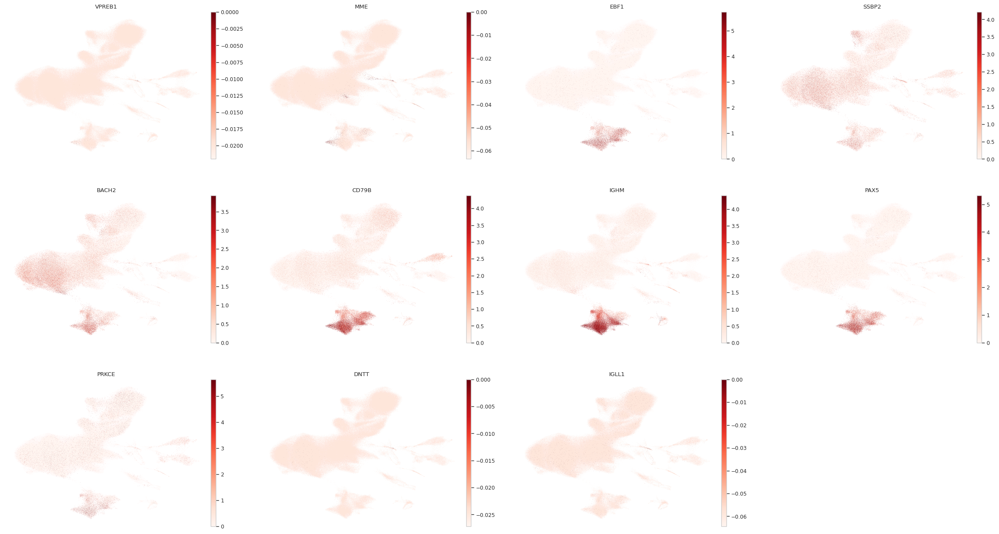





ID2-HI MYELOID PROG:


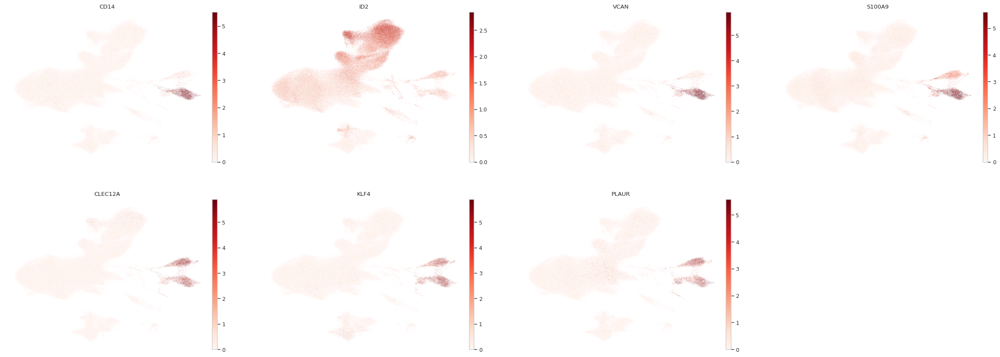

In [59]:
for ct in hpc_ct:
    print(f"{ct.upper()}:")
    sc.pl.umap(
        corona_ann,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap="Reds",  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
    )
    print("\n\n\n")  # print white space for legibility

#### Monos

In [125]:
mono_ct = ["CD14+ Mono", "CD16+ Mono", "cDC1", "cDC2", "pDC"]

CD14+ MONO:


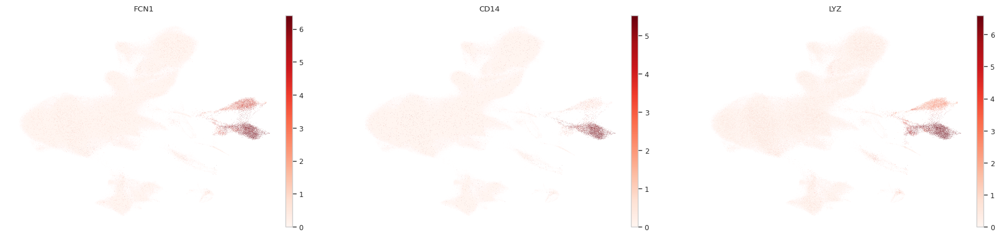





CD16+ MONO:


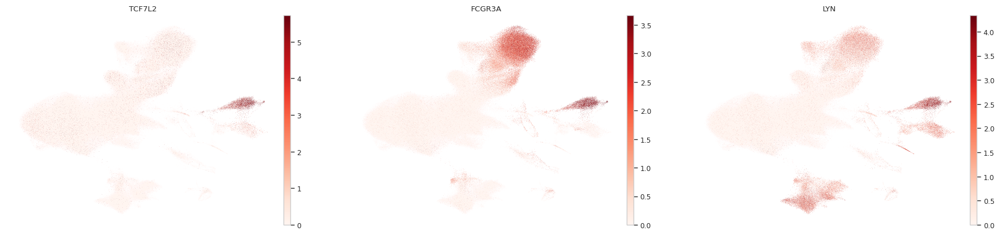





CDC1:


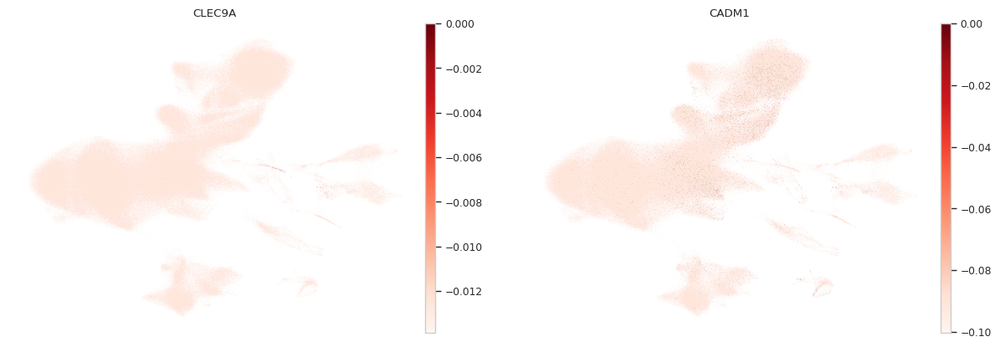





CDC2:


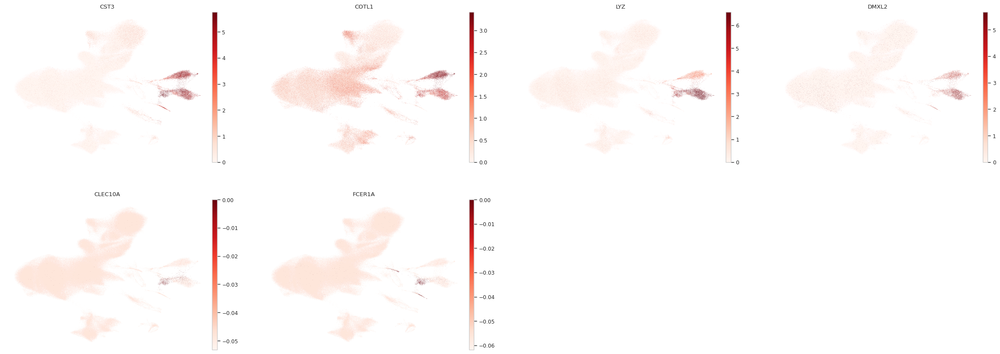





PDC:


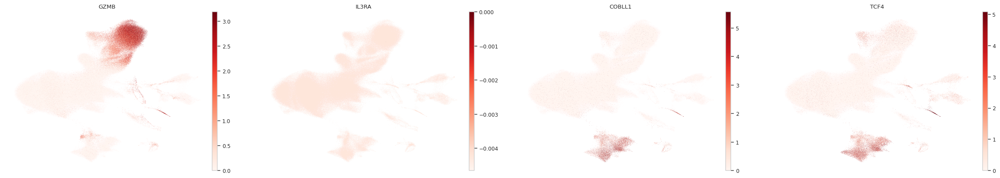

In [126]:
for ct in mono_ct:
    print(f"{ct.upper()}:")  # print cell subtype name
    sc.pl.umap(
        corona_ann,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap="Reds",  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
    )
    print("\n\n\n")  # print white space for legibility

#### B Cells

In [51]:
b_ct = ["B", "Naive CD20+ B", "B1 B", "Transitional B", "Plasma cells", "Plasmablast"]

B:


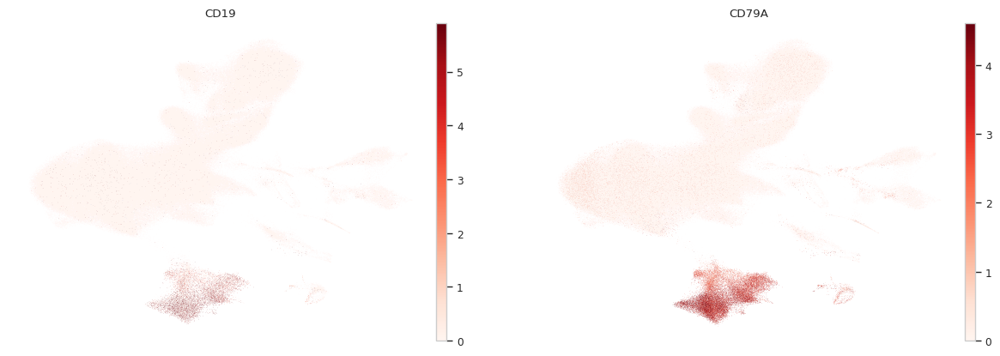





NAIVE CD20+ B:


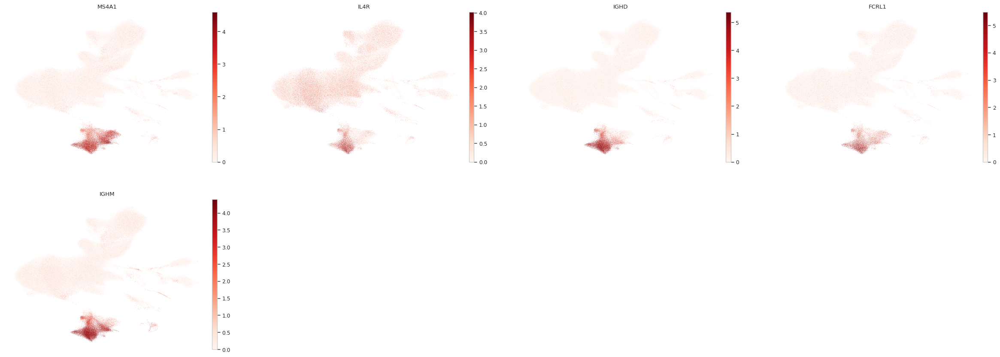





B1 B:


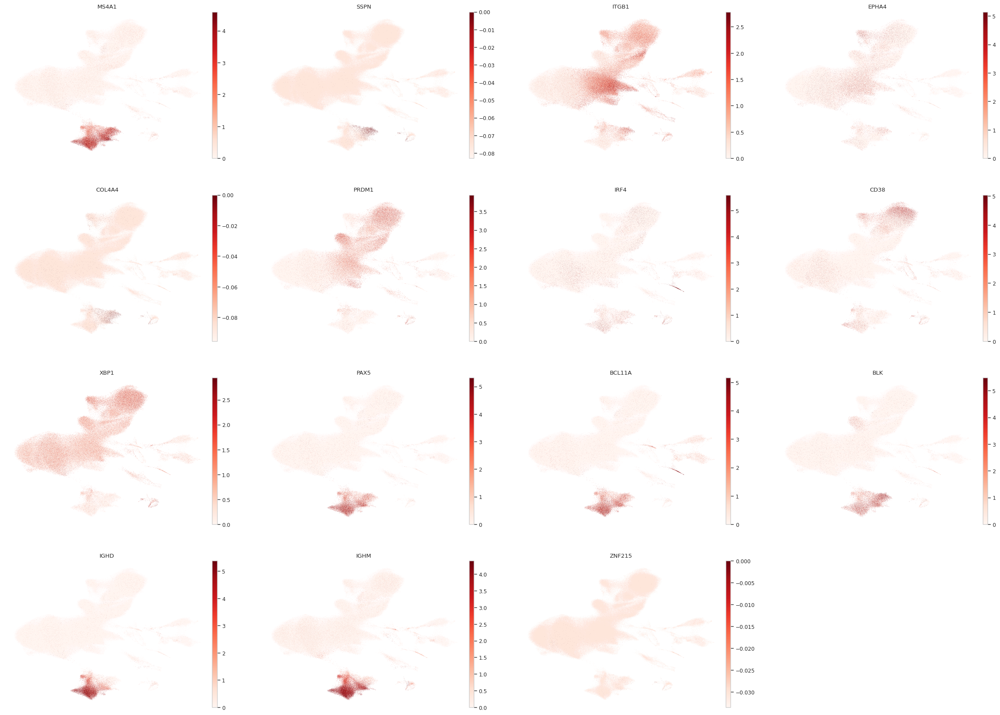





TRANSITIONAL B:


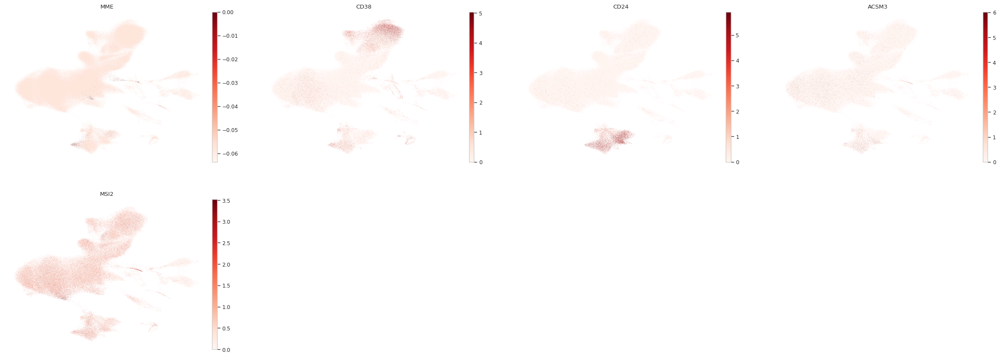





PLASMA CELLS:


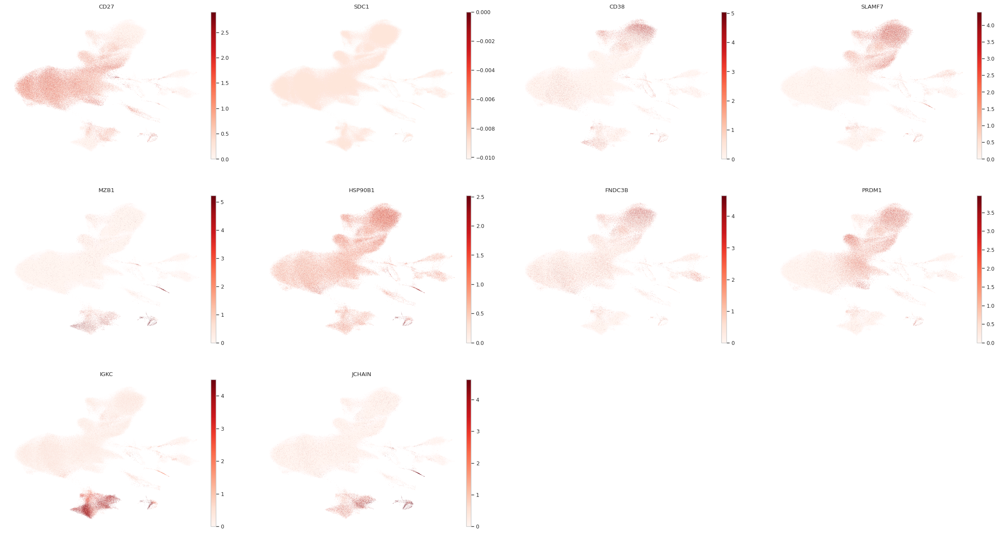





PLASMABLAST:


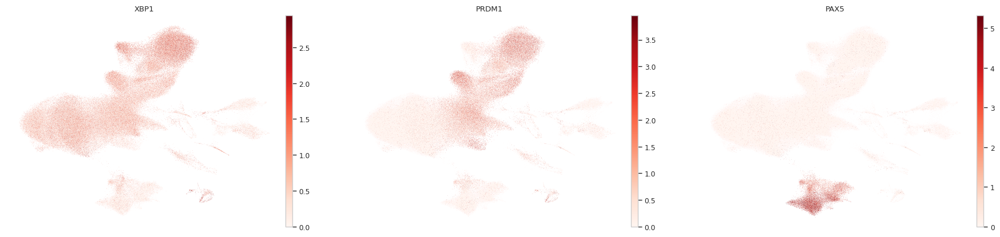

In [56]:
for ct in b_ct:
    print(f"{ct.upper()}:")  # print cell subtype name
    sc.pl.umap(
        corona_ann,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap="Reds",  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
    )
    print("\n\n\n")  # print white space for legibility

#### TNK Cells

NK:


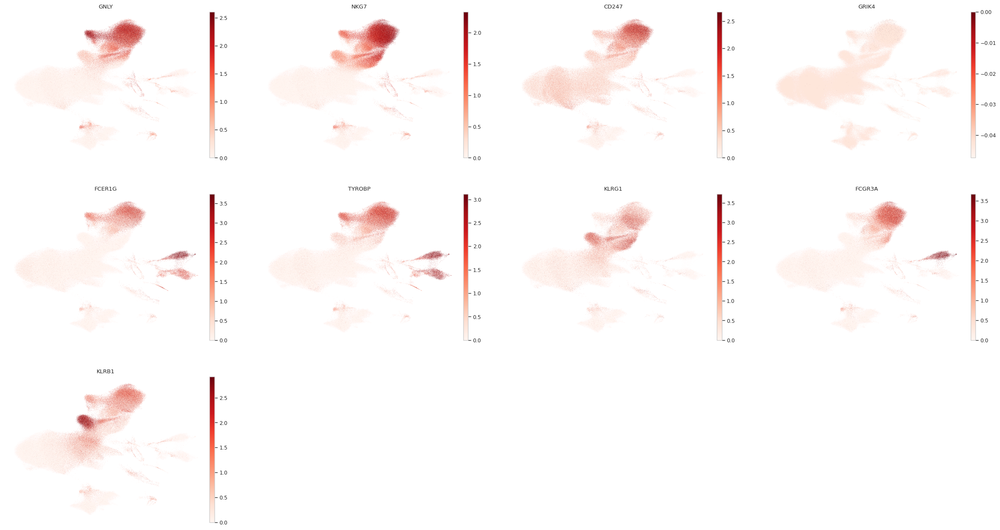





T:


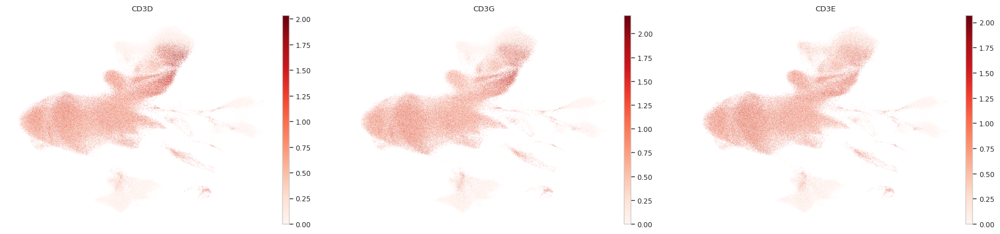





T REG:


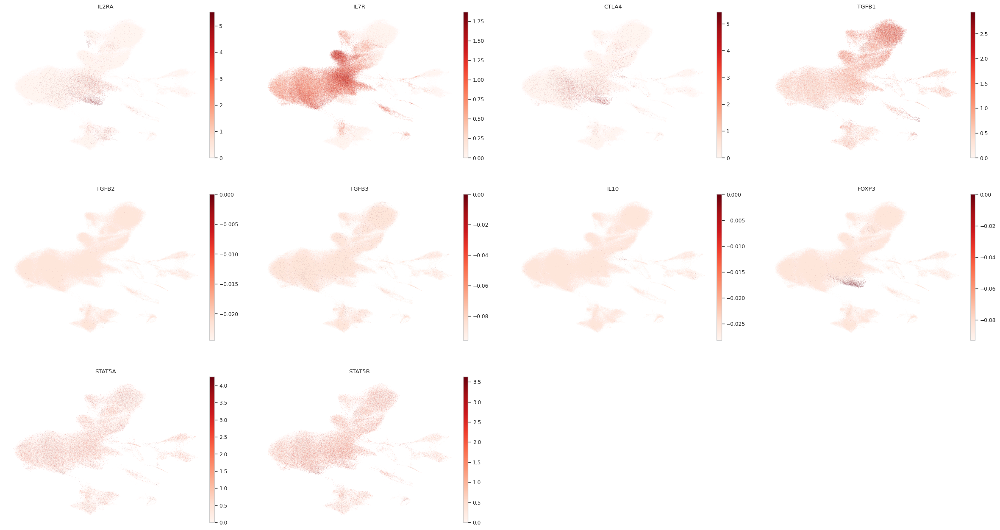





CD4+ T ACTIVATED:


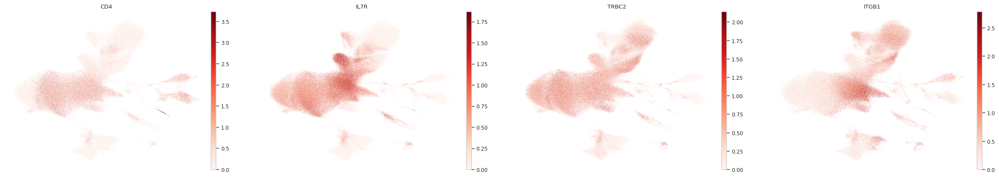





CD4+ T NAIVE:


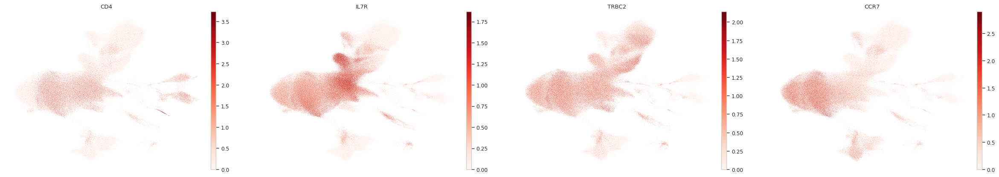





CD8+ T:


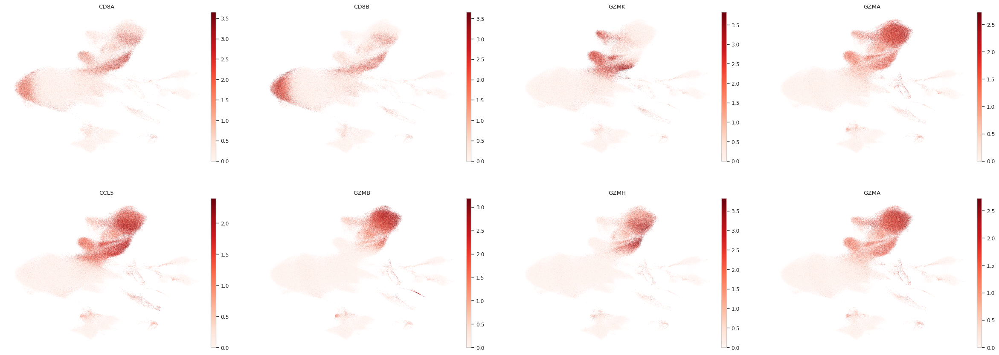





T ACTIVATION:


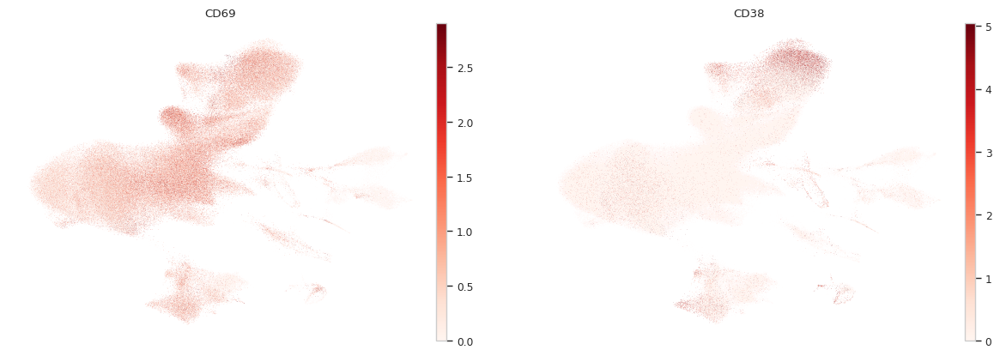





T NAIVE:


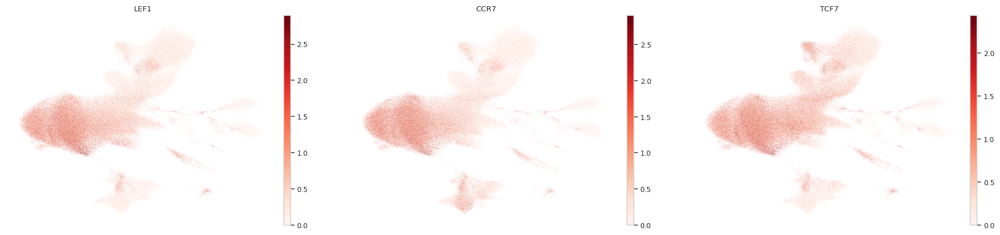

In [53]:
tnk_ct = ["NK", "T", "T reg", "CD4+ T activated", "CD4+ T naive", "CD8+ T", "T activation", "T naive"]
for ct in tnk_ct:
    print(f"{ct.upper()}:")  # print cell subtype name
    sc.pl.umap(
        corona_ann,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap="Reds",  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
    )
    print("\n\n\n")  # print white space for legibility

### Leiden Clusters Dotplot

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


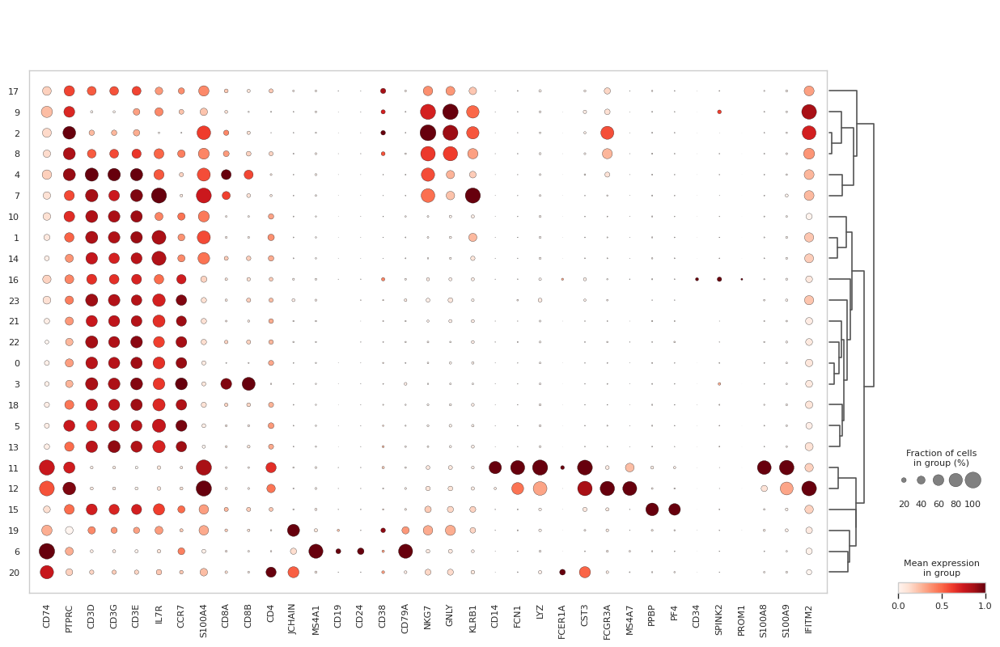

In [36]:
sc.tl.dendrogram(corona_ann, groupby="leiden", use_rep="X_pca_harmony")
sc.pl.dotplot(corona_ann, pbmc_markers, groupby='leiden', dendrogram=True, standard_scale="var", cmap="Reds")

In [37]:
annotation = {
 "9": "B",
 "14": "Megakaryocytes",
 "12": "CD14+Monocytes",
 "13": "CD16+Monocytes",
 "15": "NK",
 "1": "NK",
 "10": "NK",
 "21": "Mast/HSC",
 "19": "myeloid progenitor/DC?/MC?",
 "17": "Plasma",
 "11": "Treg",  # IL2RA, CTLA4, CD4
 "5": "CD4+TBA",
 "3": "CD4+TBA",
 "20": "CD4+TBA", # "CD4+T"
 "8": "CD4+TBA",
 "0": "CD4+TBA",
 "2": "CD4+TBA",
 "18": "CD4+TBA",
 "7": "CD4+TBA", # "CD4+T (naive)"
 "6": "CD8+T mem/naive",
 "4": "CD8+T/NK"
}

#corona_ann.obs["cell_type"][corona_ann.obs.leiden.isin(["8", "0", "2", "18", "7", "6", "5", "3", "20", "11"])] = "T"
#corona_ann.obs["cell_type"][corona_ann.obs.leiden.isin(["4"])] = "T/NK"

### Annotations

In [219]:
annotations = {
    "3": "naive CD8+ T",
    "4": "CD8+ T",
    "7": "CD8+ T",
    "8": "T/NK",
    "2": "T/NK",
    "9": "NK",
    "0": "naive CD4+ T",
    "5": "naive CD4+ T",
    "10": "CD4+ Treg",
    "14": "CD4+ T",
    "1": "CD4+ T",
    "13": "CLP",
    "16": "CLP",
    "18": "CLP",
    "21": "CLP",
    "22": "CLP",
    "23": "CLP",
    "17": "HSC",
    "15": "MK",
    "6": "B",
    "20": "Plasma",
    "19": "Plasma",
    "11": "CD14+ Mono",
    "12": "CD16+ Mono"
}

In [220]:
corona_ann.obs["cell_type"] = corona_ann.obs["leiden"].map(annotations)

In [133]:
corona_ann.obs.to_csv("/home/ubuntu/data/COVACS_annotations.csv", index=True, header=True, quoting=None)

#### Check Back

In [135]:
sc.tl.rank_genes_groups(corona_ann, "cell_type", use_raw=False, method="t-test")

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.

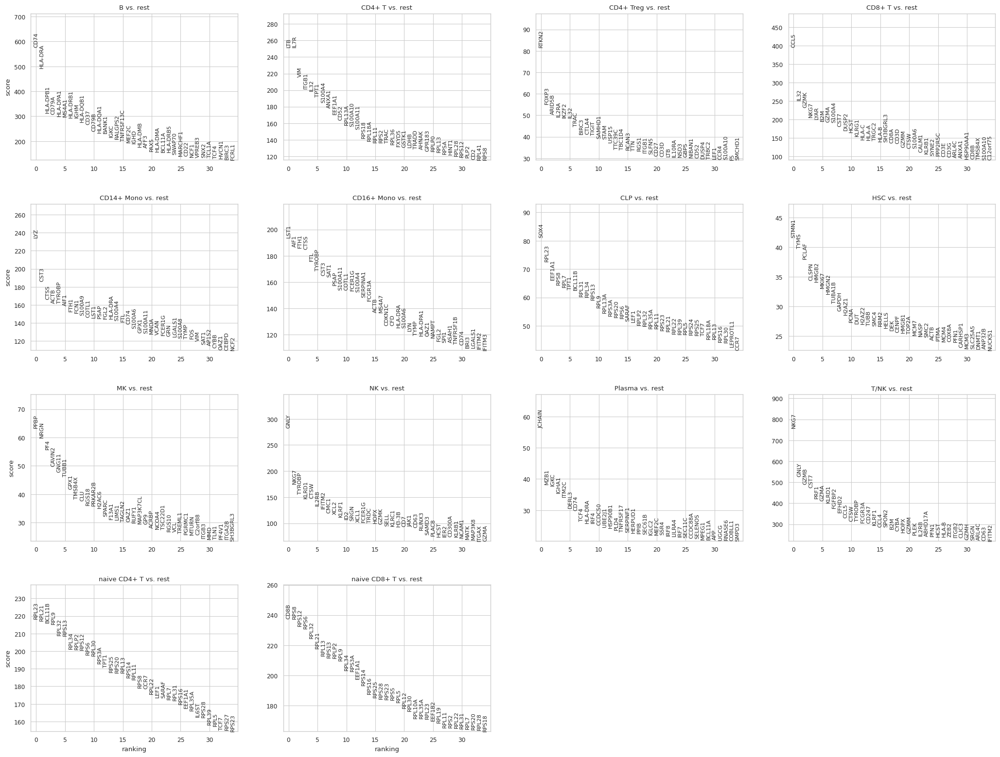

In [136]:
sc.pl.rank_genes_groups(corona_ann, n_genes=35, sharey=False, save=True)

In [137]:
sc.tl.dendrogram(corona_ann, groupby="cell_type", use_rep="X_pca_harmony")

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


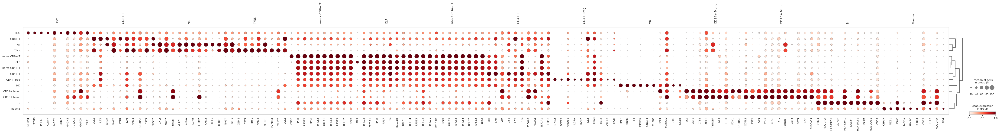

In [138]:
sc.pl.rank_genes_groups_dotplot(corona_ann, standard_scale="var", cmap="Reds", save=True)

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:368: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


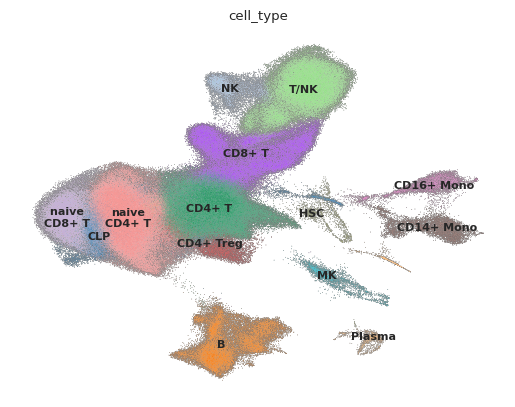

In [217]:
corona_ann.obsm["X_umap"] = corona_ann.obsm["X_umap_harmony"]
fig = sc.pl.umap(corona_ann, color=["cell_type"], add_outline=True, legend_loc="on data", title=None, frameon=False, legend_fontsize="small", return_fig=True)
fig.savefig(os.path.join(FIGURE_DIR, "covid_processed_corrected_umap_cell_types.png"))

In [244]:
pos_markers = ["GNLY", "NKG7", "CD8A", "CCL5",  "CD3D", "CCR7", "CD4", "FOXP3", "CTLA4", "PF4", "PPBP", "FCER1G", "CD14", "LYZ", "MS4A1", "IGHA1", "JCHAIN"]

In [246]:
fig = sc.pl.dotplot(corona_ann[~corona_ann.obs.cell_type.isin(["HSC","CLP"])],
                    pos_markers,
                    categories_order=['NK', 'T/NK', 'CD8+ T', 'naive CD8+ T',
                                      'naive CD4+ T', 'CD4+ T', 'CD4+ Treg',
                                      'MK', 'CD16+ Mono', 'CD14+ Mono', 'B', 'Plasma'],
                    groupby='cell_type',
                    dendrogram=False,
                    swap_axes=False,
                    standard_scale="var",
                    cmap="Reds",
                    return_fig=True)
fig.add_totals()
#fig.savefig(os.path.join(FIGURE_DIR, "covid_marker_expression_by_cell_type_noprec.png"))

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


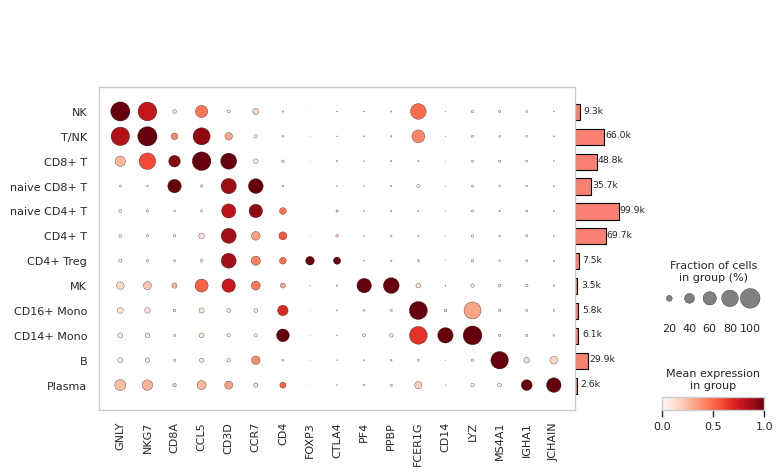

In [247]:
fig.show()

#### Cell Composition

In [396]:
corona_ann.obs.sampleID.isin(["58", "30", "31", "32", "29", "20", "21", "60", "44"]).any()

False

In [370]:
latex_tab = corona_ann[corona_ann.obs.cohort == "P"].obs.copy().groupby(["timepoint"])["patientID"].unique().to_latex()
print(latex_tab)

\begin{tabular}{ll}
\toprule
 & patientID \\
timepoint &  \\
\midrule
M6 & ['P8', 'P16', 'P7', 'P6', 'P4']
Categories (5, object): ['P4', 'P6', 'P7', 'P8', 'P16'] \\
d1 & ['P7', 'P4', 'P16', 'P8', 'P6']
Categories (5, object): ['P4', 'P6', 'P7', 'P8', 'P16'] \\
d28 & ['P16', 'P6', 'P4', 'P7', 'P8']
Categories (5, object): ['P4', 'P6', 'P7', 'P8', 'P16'] \\
d56 & ['P8', 'P7', 'P4', 'P16', 'P6']
Categories (5, object): ['P4', 'P6', 'P7', 'P8', 'P16'] \\
\bottomrule
\end{tabular}



In [371]:
latex_tab = corona_ann[corona_ann.obs.cohort == "B"].obs.copy().groupby(["timepoint"])["patientID"].unique().to_latex()
print(latex_tab)

\begin{tabular}{ll}
\toprule
 & patientID \\
timepoint &  \\
\midrule
t1 & ['B4', 'B9', 'B10', 'B13', 'B2', 'B6', 'B3', 'B1', 'B12']
Categories (9, object): ['B1', 'B2', 'B3', 'B4', ..., 'B9', 'B10', 'B12', 'B13'] \\
t2 & ['B4', 'B6', 'B3', 'B13', 'B1', 'B12', 'B2']
Categories (9, object): ['B1', 'B2', 'B3', 'B4', ..., 'B9', 'B10', 'B12', 'B13'] \\
t3 & ['B12', 'B13', 'B4', 'B1', 'B6']
Categories (9, object): ['B1', 'B2', 'B3', 'B4', ..., 'B9', 'B10', 'B12', 'B13'] \\
t4 & ['B9', 'B12', 'B10', 'B1', 'B4']
Categories (9, object): ['B1', 'B2', 'B3', 'B4', ..., 'B9', 'B10', 'B12', 'B13'] \\
\bottomrule
\end{tabular}



In [446]:
# sort timepoint categories by hand ...
corona_ann.obs.timepoint = pd.Categorical(corona_ann.obs.timepoint, 
                                          categories=["t1","t2", "t3", "t4", "d1", "d28", "d56", "M6"], 
                                          ordered=True)

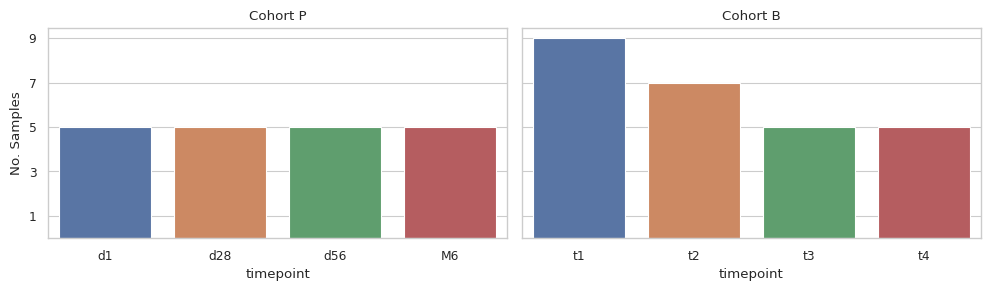

In [494]:
cohort_b_samples_by_timepoint = corona_ann[corona_ann.obs.cohort == "B"].obs.copy().groupby(["timepoint"])["patientID"].agg(["nunique"]).reset_index()
cohort_p_samples_by_timepoint = corona_ann[corona_ann.obs.cohort == "P"].obs.copy().groupby(["timepoint"])["patientID"].agg(["nunique"]).reset_index()

fig, (a1, a2) = plt.subplots(nrows=1, ncols=2, figsize=(10,3), sharey=True)

sns.barplot(cohort_p_samples_by_timepoint, x="timepoint", y="nunique", ax=a1)
sns.barplot(cohort_b_samples_by_timepoint, x="timepoint", y="nunique", ax=a2)

a1.set_title("Cohort P")
a2.set_title("Cohort B")
a2.set_ylabel("")
a1.set_ylabel("No. Samples")

a1.set_yticks([1,3,5,7,9])
fig.tight_layout()
fig.savefig("num_samples_by_timepoint.png")

In [479]:
composition_p = corona_ann[corona_ann.obs.cohort == "P"].obs.copy().groupby(["timepoint", "cell_type"]).count().iloc[:,1]
composition_b = corona_ann[corona_ann.obs.cohort == "B"].obs.copy().groupby(["timepoint", "cell_type"]).count().iloc[:,1]

agg_name = "Count"
composition_p.name = agg_name
composition_b.name = agg_name

composition_p = pd.DataFrame(composition_p).reset_index()
composition_b = pd.DataFrame(composition_b).reset_index()


composition_p["Relative_Count"] = None
for i, t in enumerate(cohort_p_samples_by_timepoint.timepoint):
    n_samples = cohort_p_samples_by_timepoint.iloc[i]["nunique"]
    composition_p.loc[composition_p.timepoint == t, "Relative_Count"] = (composition_p.loc[composition_p.timepoint == t, "Count"]  / n_samples)

composition_b["Relative_Count"] = None
for i, t in enumerate(cohort_b_samples_by_timepoint.timepoint):
    n_samples = cohort_b_samples_by_timepoint.iloc[i]["nunique"]
    composition_b.loc[composition_b.timepoint == t, "Relative_Count"] = (composition_b.loc[composition_b.timepoint == t, "Count"]  / n_samples)

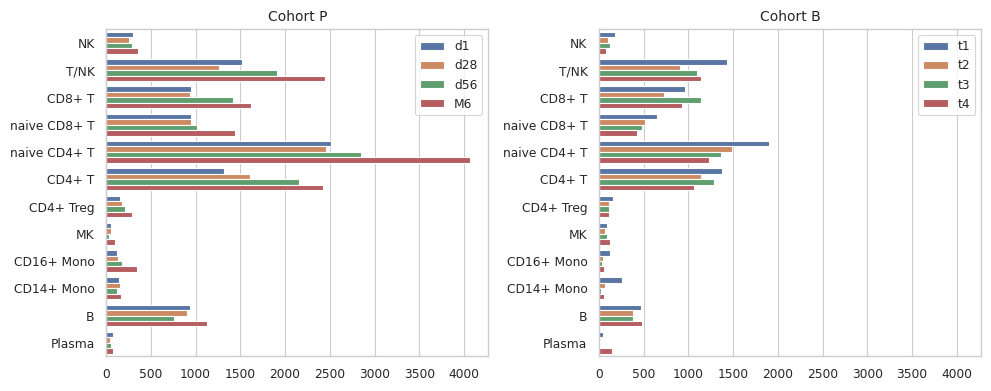

In [492]:
fig, (a1, a2) = plt.subplots(nrows=1, ncols=2, figsize=(10,4), sharex=True)

cell_type_order = ['NK', 'T/NK', 'CD8+ T', 'naive CD8+ T',
                   'naive CD4+ T', 'CD4+ T', 'CD4+ Treg',
                   'MK', 'CD16+ Mono', 'CD14+ Mono', 'B', 'Plasma'] 

sns.barplot(data=composition_p.unstack(), x="Relative_Count", y="cell_type", hue="timepoint", orient="h", ax=a1, order=cell_type_order)
sns.barplot(data=composition_b.unstack(), x="Relative_Count", y="cell_type", hue="timepoint", orient="h", ax=a2, order=cell_type_order)

a1.set_title("Cohort P", size=10)
a2.set_title("Cohort B", size=10)

fig.tight_layout()
fig.savefig("cell_type_composition.png")

Text(0.5, 1.0, 'Cohort B')

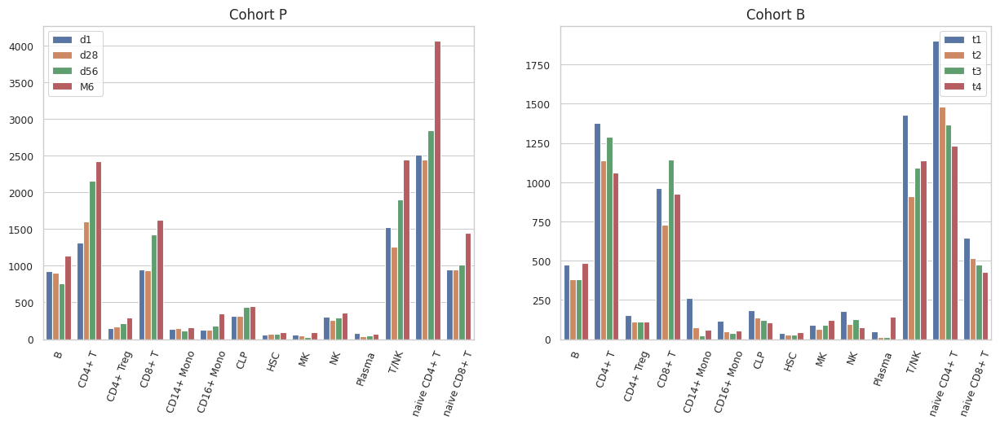

In [486]:
fig, (a1, a2) = plt.subplots(nrows=1, ncols=2, figsize=(15,5), sharex=True)

sns.barplot(data=composition_p.unstack(), y="Relative_Count", x="cell_type", hue="timepoint", orient="v", ax=a1)
sns.barplot(data=composition_b.unstack(), y="Relative_Count", x="cell_type", hue="timepoint", orient="v", ax=a2)

a1.tick_params(axis="x", rotation=70)
a2.tick_params(axis="x", rotation=70)

a1.set_title("Cohort P", size=12)
a2.set_title("Cohort B", size=12)

#### OLD CLUSTERS: Cluster 19

- HLA
- CD74: MHC II
- PLD4: 5'->3' DNA exonuclease which digests single-stranded DNA (ssDNA)
- TCF4: immunoglobulin transcription factor 2 (ITF-2) (yes!)
- BCL11A: Erythropoiesis transition ???
- IRF8: Interferon regulatory factor 8. Hihgly expressed in myeloid cells. Mediate apoptosis in non-hemotopoietic cancer cells
- LILRA4: encodes an immunoglobulin-like cell surface protein preferentially expressed in plasmacytoid dendritic cells (PDCs)
- JCHAIN: Plasma cells, also early stages of lymphoid cell differentiation as it is expressed in both B and T cell precursors
- CST3: Cystatin C. 
- SERPINF1: Pigment epithelium-derived factor (PEDF). Has anti-angiogenic, anti-tumorigenic, and neurotrophic functions
- MPEG1: Macrophage Expressed 1. antibacterial (gram-negative)
- SPIB: DNA-binding, transcription factor
- PTPRE: Receptor-type tyrosine-protein phosphatase epsilon
- GPX1: Glutathione peroxidase 1. Peroxid-stress response
- GZMB: Granzyme B. Cytotoxicity
- IRF4: Interferon regulatory factor 4. Differentiation of T lymphocytes and B lymphocytes as well as certain myeloid cells
- GRN: Granulin. Development, inflammation, cell proliferation and protein homeostasis

* **RESULT: Antigen-presenting, differentiation (Lymphoid, Myeloid), Antibody-secretion (?), stress-response (?), cytotoxicity**
* **Dendritic Cells? -> CST3, but monocyte markers not expressed**
* **Lymphoid Progenitor? -> Why Myeloid differentiation? Why cytotoxicity/stress-response? PTPRC Expressed (CD45) -> Differntiated (?)** 

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


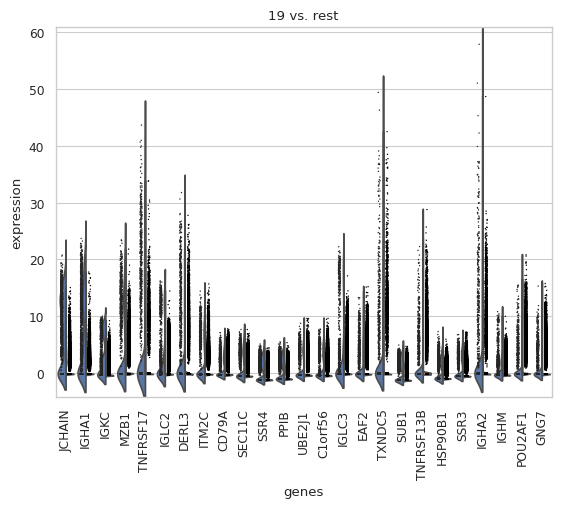

In [38]:
sc.pl.rank_genes_groups_violin(corona_ann, groups=["19"], n_genes=25)

#### OLD CLUSTERS: Cluster 21

- SOX4: Transcription factor SOX-4. Embryonic development, cell fate determination
- CDK6: Cell cycle. Association with T-cell 
- HLA-DRA/CD74: MHC II
- GPX1: Glutathione peroxidase 1. Peroxid-stress response
- CD38-
- A portion of the cluster is CD34+: haematopoietic cells, or in endothelial progenitor cells, endothelial cells of blood vessels but not lymphatics (except pleural lymphatics), mast cells, a sub-population of dendritic cells (which are factor XIIIa-negative (F13A1))
- **Result: Myeloid, maybe DC subtype** 

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


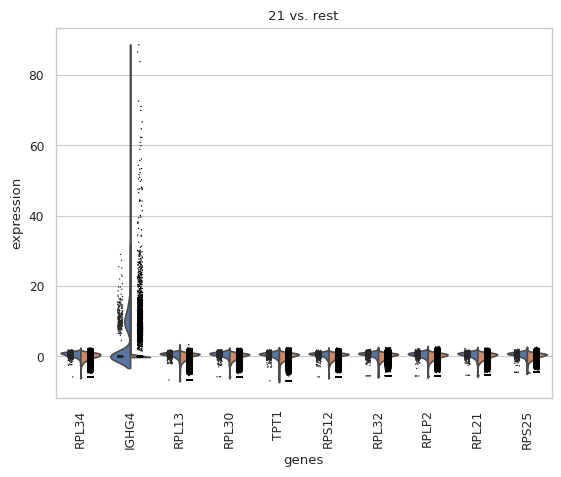

In [39]:
sc.pl.rank_genes_groups_violin(corona_ann, groups=["21"], n_genes=10)

#### OLD CLUSTERS: Cluster 17

* JCHAIN: Plasma B cells
* IGHA1, IGKC, IGLC2: Immunoglobulines
* MZB1: MZB1 (Marginal Zone B And B1 Cell Specific Protein)
* CD20+CD27+CD43+CD70- -> B1
* **RESULT: Plasma B-cells**

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


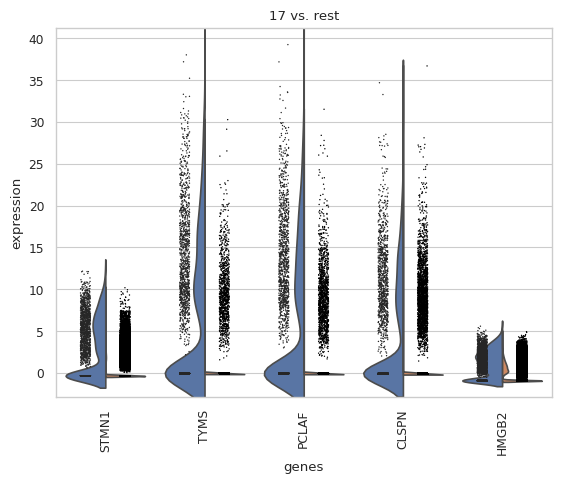

In [40]:
sc.pl.rank_genes_groups_violin(corona_ann, groups=["17"], n_genes=5)

/home/ubuntu/.local/share/virtualenvs/masterthesis-aGTe3VWb/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


KeyError: 'Could not find key cell_type in .var_names or .obs.columns.'

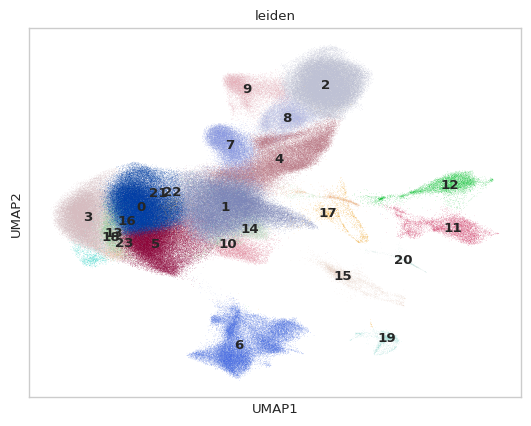

In [41]:
corona_ann.obsm["X_umap"] = corona_ann.obsm["X_umap"]
sc.pl.umap(corona_ann, color=["leiden", "cell_type"], legend_loc="on data")

In [ ]:
#corona_ann.uns["rank_gene_groups"] = None
#sc.tl.rank_genes_groups(corona_ann, "cell_type", use_raw=False, method="wilcoxon")

In [ ]:
#sc.tl.dendrogram(corona_ann, "cell_type")
#sc.pl.rank_genes_groups_heatmap(corona_ann, n_genes=20, show_gene_labels=True)

## Save Batch Correction, Clustering and Annotations

In [97]:
from scipy import sparse
corona_ann.raw = None
##del corona_ann.layers["lognorm_counts"]

# resets scaling!
corona_ann.X = sparse.csr_matrix(corona_ann.layers["lognorm_counts"])
del corona_ann.layers["lognorm_counts"]
del corona_ann.layers["counts"]
corona_ann.write("/home/ubuntu/data/COVAC_corrected_annotated.h5ad")